# 01_Plot_Embeddings

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
import os
import scanpy as sc
import pandas as pd

# approximate original figure in http://spatial.libd.org/spatialLIBD/
palette_celltype={'L1':'#eb34a8',
                  'L2':'#3486eb',
                  'L3':'#34eb5b',
                  'L4':"#ae34eb",
                  'L5':'#ebdb34',
                  'L6':'#eb9234',
                  'WM':'#000000'}

palette_entity_anno = palette_celltype.copy()
palette_entity_anno['gene'] = "lightgray"

import simba as si

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_simba_only/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
si.settings.set_figure_params(
    dpi=80,
    style='white',
    fig_size=[5,5],
    rc={'image.cmap': 'viridis'}
)

from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('retina')
import matplotlib.pyplot as plt

In [6]:
from benchmarking.plot import generate_umap_figures, generate_pca_figures, combine_images, generate_spatial_kernel_figures

# PCA

In [7]:
pca_fn = "../results/00/pca_rna/run_pca.output.tsv"

In [8]:
pca_output_df = pd.read_csv(pca_fn, sep='\t', index_col=0)

In [12]:
f"{pca_output_df.iloc[0]}/adata_CG.h5ad"

'run_pca    ../results/00/pca_rna/151675\nName: 151675, dtype: object/adata_CG.h5ad'

In [13]:
adata = sc.read_h5ad(f"{pca_output_df.iloc[0].item()}/adata_CG.h5ad")

In [17]:
adata.obsm['X_pca'].shape

(3566, 50)

In [ ]:
pca_output_df = generate_pca_figures(
    pca_output_df,
    path_col='run_pca',
    fig_path='../results/00/pca_rna/PCA',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
    cell_embedding_adata_fn='adata_CG.h5ad'
)

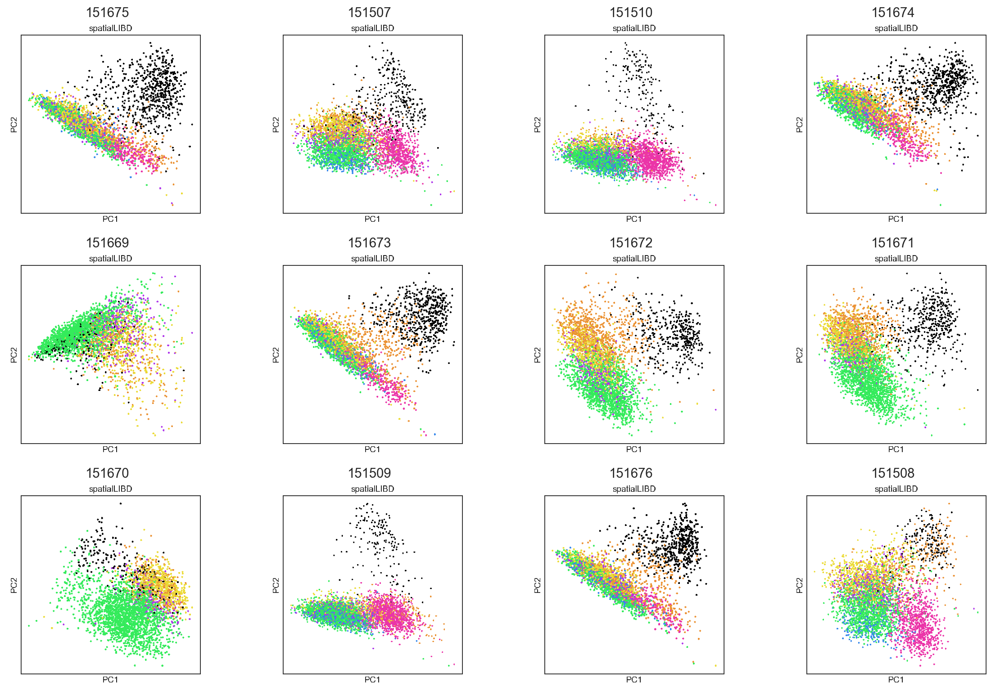

In [14]:
fig, axes = combine_images(
    pca_output_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

# Spatial PCA

In [12]:
spatialpca_fn = '../results/00/spatialpca/spatialpca_adata_py.tsv'
spatialpca_output_df = pd.read_csv(spatialpca_fn, sep='\t', index_col=0)
spatialpca_output_df['spatialPCA_dir'] = spatialpca_output_df['spatialPCA_adata_fn'].apply(lambda x: x.rsplit("/", 1)[0])
spatialpca_output_df.head()

,spatialPCA_adata_fn,spatialPCA_dir
151507,../results/00/spatialpca/151507/spatialPCA_to_...,../results/00/spatialpca/151507
151508,../results/00/spatialpca/151508/spatialPCA_to_...,../results/00/spatialpca/151508
151509,../results/00/spatialpca/151509/spatialPCA_to_...,../results/00/spatialpca/151509
151510,../results/00/spatialpca/151510/spatialPCA_to_...,../results/00/spatialpca/151510
151669,../results/00/spatialpca/151669/spatialPCA_to_...,../results/00/spatialpca/151669


In [ ]:
spatialpca_output_df = generate_pca_figures(
    spatialpca_output_df,
    path_col='spatialPCA_dir',
    fig_path='../results/00/spatialpca/PCA',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
    cell_embedding_adata_fn='spatialPCA_to_py.adata.h5ad'
)

In [16]:
spatialpca_output_df.head()

,spatialPCA_adata_fn,spatialPCA_dir,pca_fig_png,pca_fig_svg
151507,../results/00/spatialpca/151507/spatialPCA_to_...,../results/00/spatialpca/151507,../results/00/spatialpca/PCA/151507.png,../results/00/spatialpca/PCA/151507.svg
151508,../results/00/spatialpca/151508/spatialPCA_to_...,../results/00/spatialpca/151508,../results/00/spatialpca/PCA/151508.png,../results/00/spatialpca/PCA/151508.svg
151509,../results/00/spatialpca/151509/spatialPCA_to_...,../results/00/spatialpca/151509,../results/00/spatialpca/PCA/151509.png,../results/00/spatialpca/PCA/151509.svg
151510,../results/00/spatialpca/151510/spatialPCA_to_...,../results/00/spatialpca/151510,../results/00/spatialpca/PCA/151510.png,../results/00/spatialpca/PCA/151510.svg
151669,../results/00/spatialpca/151669/spatialPCA_to_...,../results/00/spatialpca/151669,../results/00/spatialpca/PCA/151669.png,../results/00/spatialpca/PCA/151669.svg


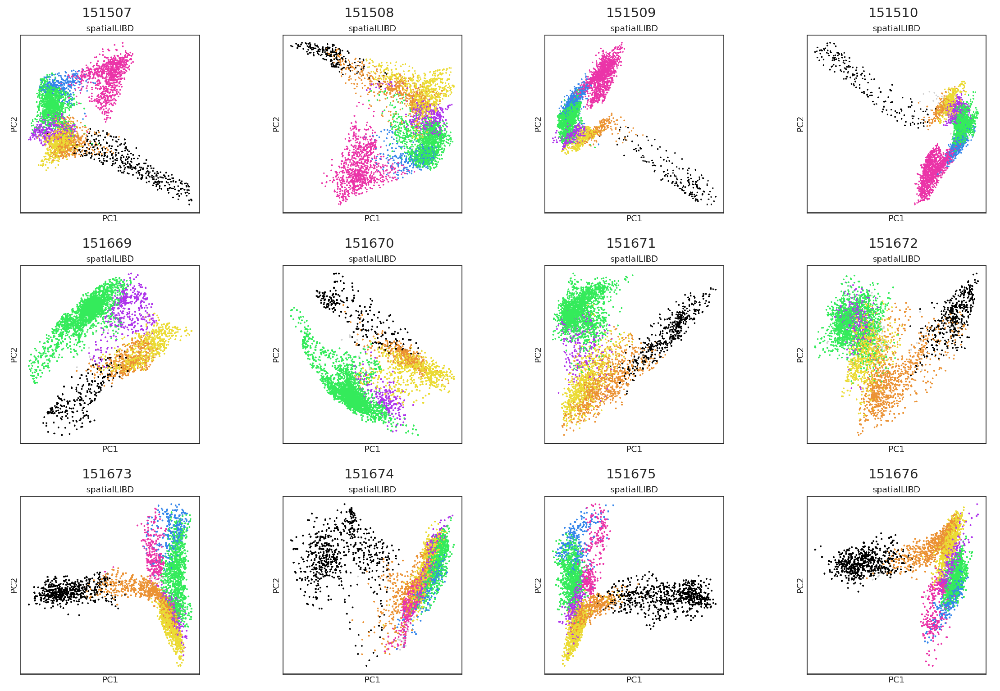

In [15]:
fig, axes = combine_images(
    spatialpca_output_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

# SIMBA RNA only

In [16]:
simba_rna_only_output_fn = "../results/00/simba_rna_only/run_simba_rna_only.output.tsv"
simba_rna_only_output_df = pd.read_csv(simba_rna_only_output_fn, sep='\t', index_col=0)

In [17]:
simba_rna_only_output_df = generate_umap_figures(
    simba_rna_only_output_df,
    path_col='run_simba_rna_only',
    fig_path='../results/00/simba_rna_only/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
)

Saving results in: ../results/00/simba_rna_only/UMAP


  0%|                                                                                                     | 0/12 [00:00<?, ?it/s]/Users/cchu/opt/anaconda3/envs/env_simba/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/cchu/opt/anaconda3/envs/env_simba/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
  8%|███████▊                                                                                     | 1/12 [00:21<03:54, 21.34s/it]/Users/cchu/opt/anaconda3/envs/env_simba/lib/python3.11/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/cchu/opt/anaconda3/envs/env_simba/lib/python3.11/site-packages/umap/umap_.py:1952: UserWa

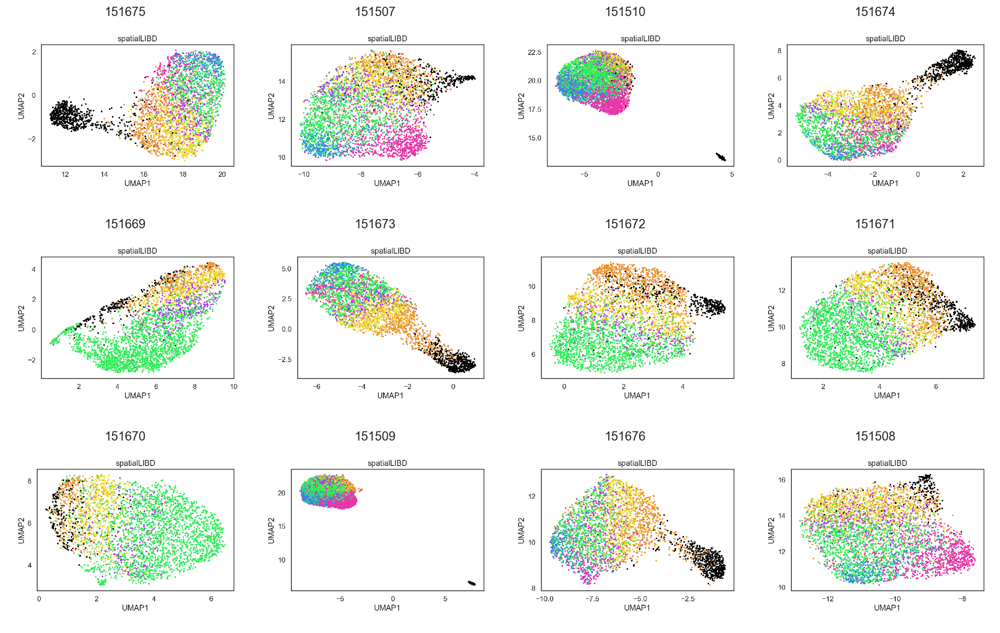

In [19]:
fig, axes = combine_images(simba_rna_only_output_df, img_path_col='umap_fig_png')
plt.show()

# SIMBA Spatial only

## Mask

In [7]:
MASK_simba_spatial_output_fn = "../results/00/simba_spatial_only/mask_r500/run_simba_spatial_only.output.tsv"
MASK_simba_spatial_output_df = pd.read_csv(MASK_simba_spatial_output_fn, sep='\t', index_col=0)

In [8]:
MASK_simba_spatial_output_df.head()

,run_simba_spatial_only
151507,../results/00/simba_spatial_only//mask_r500/15...
151508,../results/00/simba_spatial_only//mask_r500/15...
151509,../results/00/simba_spatial_only//mask_r500/15...
151510,../results/00/simba_spatial_only//mask_r500/15...
151669,../results/00/simba_spatial_only//mask_r500/15...


In [7]:
MASK_simba_spatial_output_df = generate_umap_figures(
    MASK_simba_spatial_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/mask_r500/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
)

Saving results in: ../results/00/simba_spatial_only/mask_r500/UMAP


100%|██████████| 12/12 [01:59<00:00,  9.96s/it]


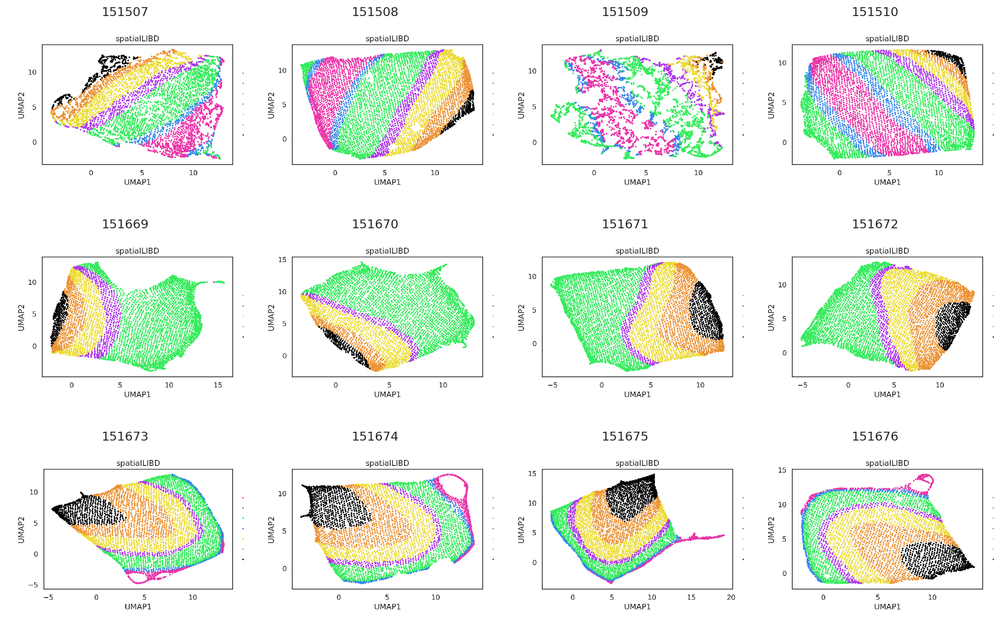

In [8]:
fig, axes = combine_images(MASK_simba_spatial_output_df, img_path_col='umap_fig_png')
plt.show()

In [16]:
MASK_simba_spatial_output_df

,run_simba_spatial_only,umap_fig_png,umap_fig_svg
151507,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151508,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151509,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151510,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151669,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151670,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151671,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151672,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151673,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...
151674,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...


In [ ]:
MASK_simba_spatial_output_df = generate_spatial_kernel_figures(
    MASK_simba_spatial_output_df,
    barcode_indices=500,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/mask_r500/SPATIAL_KERNEL',
    fig_exts=['png', 'svg'],
)

In [21]:
MASK_simba_spatial_output_df

,run_simba_spatial_only,umap_fig_png,umap_fig_svg,spatial_kernel_fig_png,spatial_kernel_fig_svg
151507,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151508,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151509,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151510,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151669,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151670,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151671,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151672,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151673,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...
151674,../results/00/simba_spatial_only//mask_r500/15...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/UMA...,../results/00/simba_spatial_only/mask_r500/SPA...,../results/00/simba_spatial_only/mask_r500/SPA...


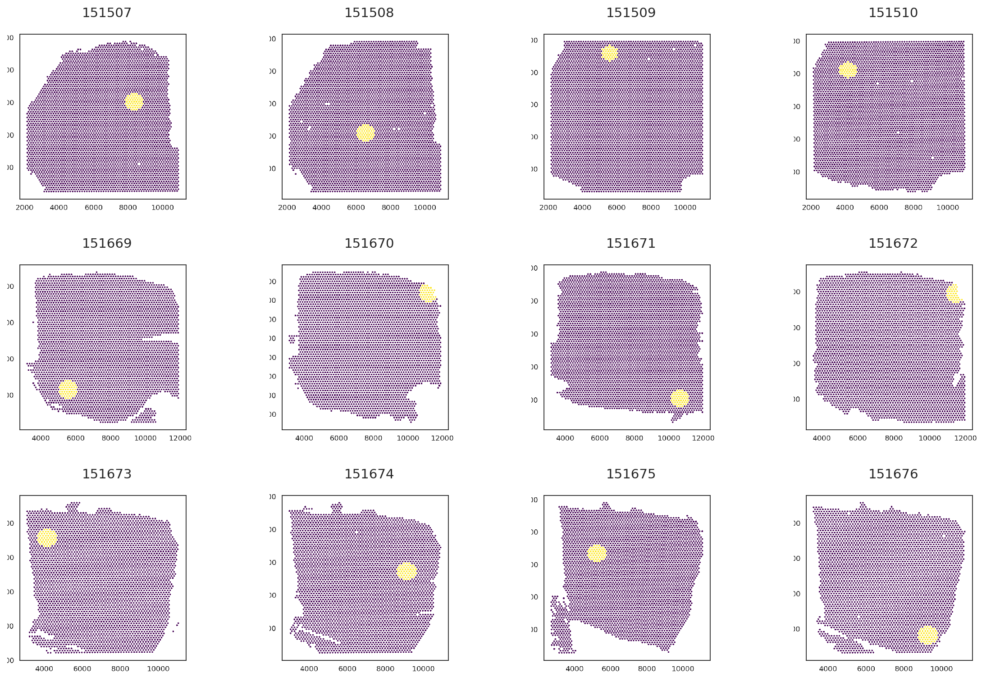

In [24]:
fig, axes = combine_images(
    MASK_simba_spatial_output_df, img_path_col='spatial_kernel_fig_png',
    x_min=50, x_max=950,
    y_min=50, y_max=900
)
plt.show()

## Gaussian

In [9]:
GAUSSIAN_simba_spatial_output_fn = "../results/00/simba_spatial_only/gaussian_e3/run_simba_spatial_only.output.tsv"
GAUSSIAN_simba_spatial_output_df = pd.read_csv(GAUSSIAN_simba_spatial_output_fn, sep='\t', index_col=0)

In [10]:
GAUSSIAN_simba_spatial_output_df = generate_umap_figures(
    GAUSSIAN_simba_spatial_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/gaussian_e3/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
)

Saving results in: ../results/00/simba_spatial_only/gaussian_e3/UMAP


100%|██████████| 12/12 [01:45<00:00,  8.80s/it]


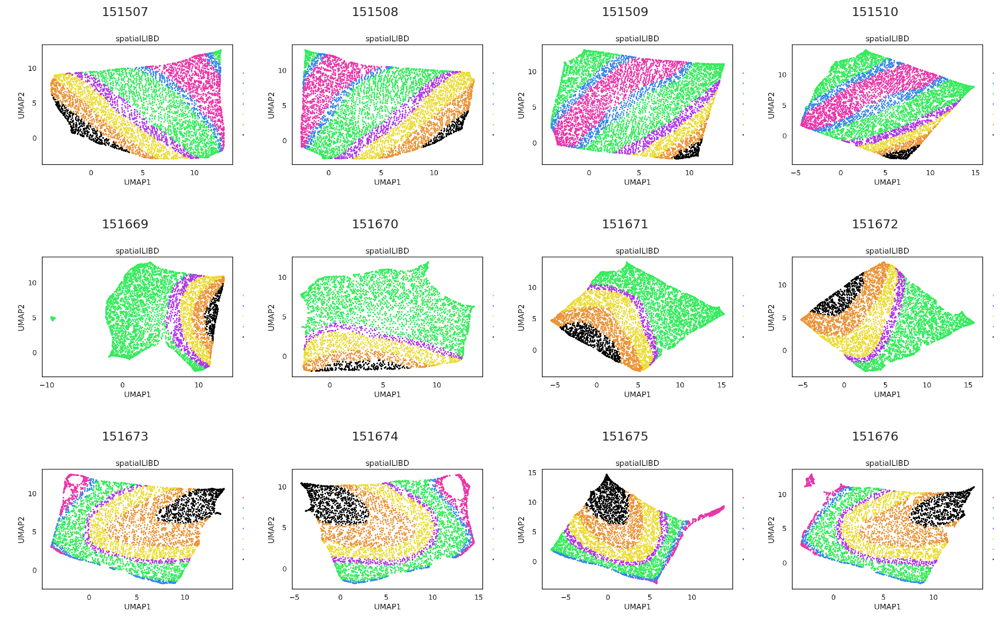

In [11]:
fig, axes = combine_images(GAUSSIAN_simba_spatial_output_df, img_path_col='umap_fig_png')
plt.show()

In [ ]:
GAUSSIAN_simba_spatial_output_df = generate_spatial_kernel_figures(
    GAUSSIAN_simba_spatial_output_df,
    barcode_indices=500,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/gaussian_e3/SPATIAL_KERNEL',
    fig_exts=['png'],
)

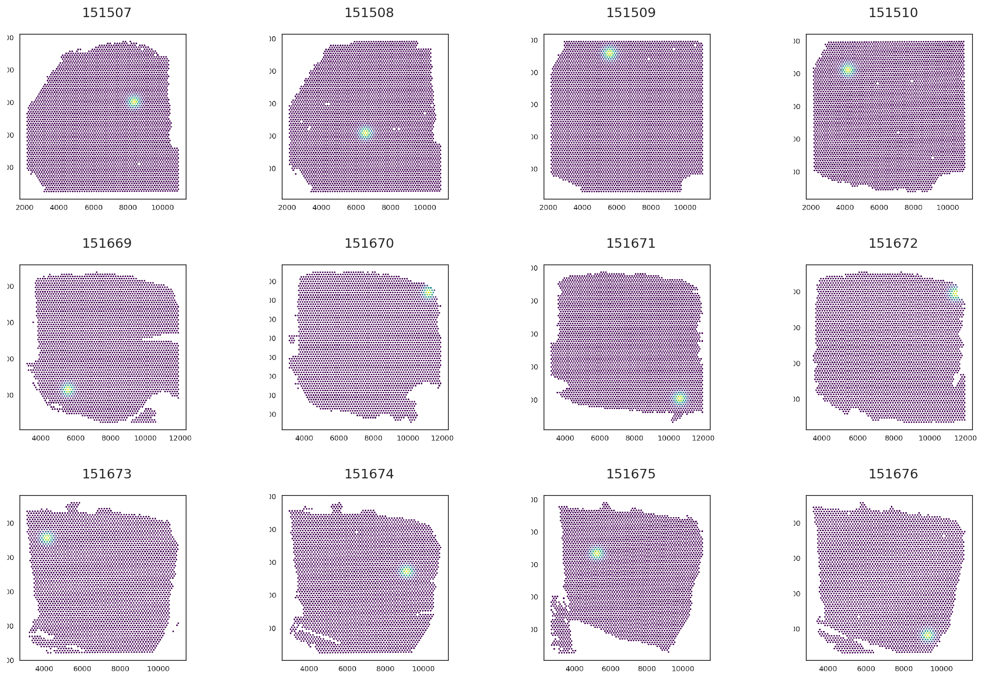

In [26]:
fig, axes = combine_images(
    GAUSSIAN_simba_spatial_output_df, img_path_col='spatial_kernel_fig_png',
    x_min=50, x_max=950,
    y_min=50, y_max=900
)
plt.show()

## RBF

In [12]:
RBF_simba_spatial_output_fn = "../results/00/simba_spatial_only/rbf_e5/run_simba_spatial_only.output.tsv"
RBF_simba_spatial_output_df = pd.read_csv(RBF_simba_spatial_output_fn, sep='\t', index_col=0)

In [13]:
RBF_simba_spatial_output_df = generate_umap_figures(
    RBF_simba_spatial_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/rbf_e5/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png', 'svg'],
)

Saving results in: ../results/00/simba_spatial_only/rbf_e5/UMAP


100%|██████████| 12/12 [01:45<00:00,  8.82s/it]


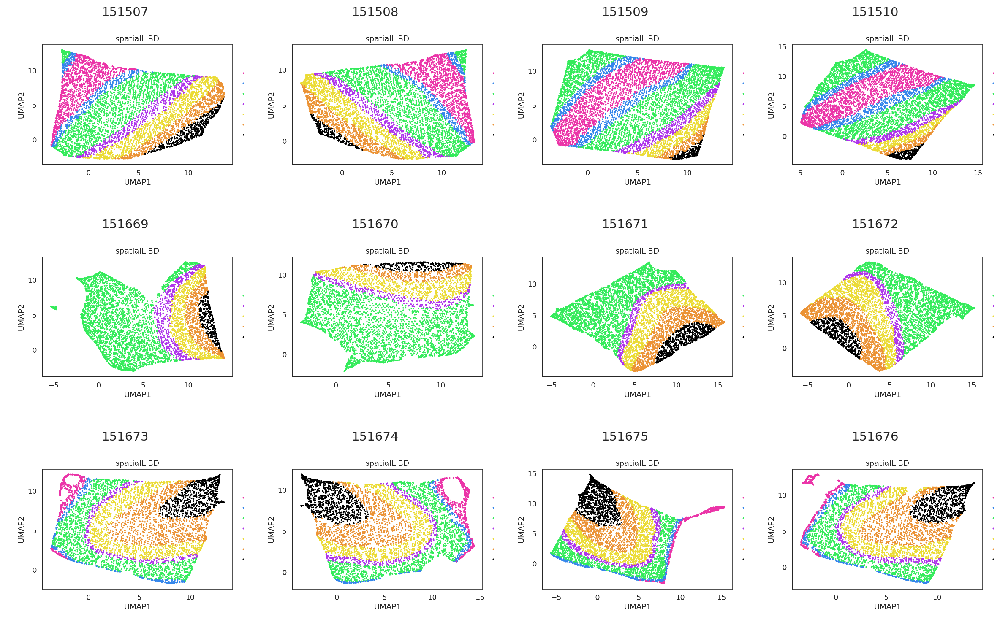

In [14]:
fig, axes = combine_images(RBF_simba_spatial_output_df, img_path_col='umap_fig_png')
plt.show()

In [ ]:
RBF_simba_spatial_output_df = generate_spatial_kernel_figures(
    RBF_simba_spatial_output_df,
    barcode_indices=500,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_only/rbf_e5/SPATIAL_KERNEL',
    fig_exts=['png'],
)

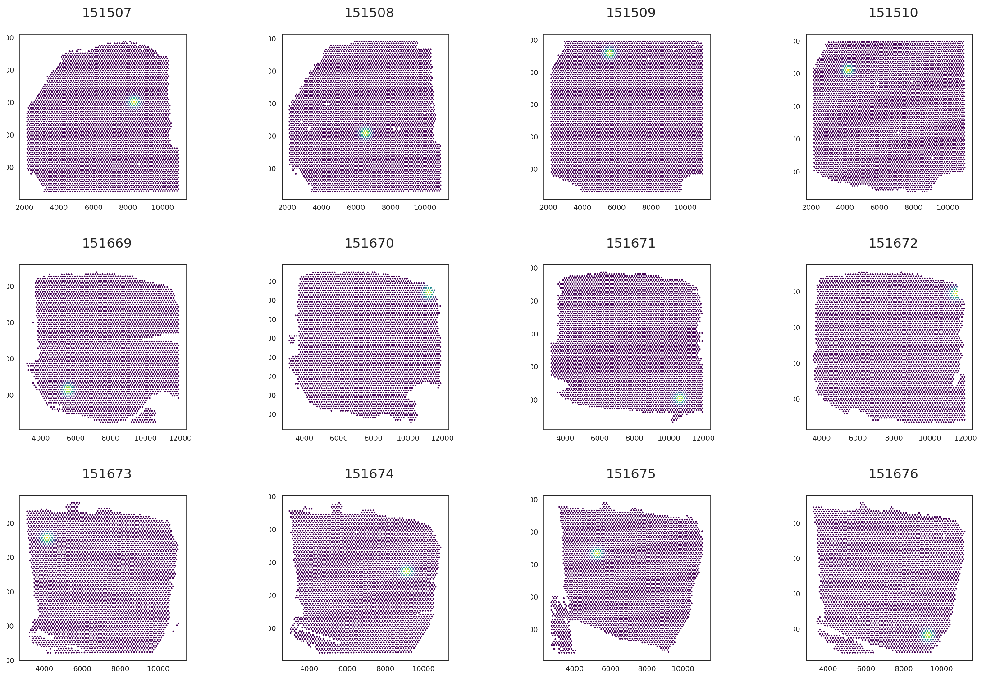

In [28]:
fig, axes = combine_images(
    RBF_simba_spatial_output_df, img_path_col='spatial_kernel_fig_png',
    x_min=50, x_max=950,
    y_min=50, y_max=900
)
plt.show()

# Spatial and RNA

## Mask + RNA (no correlation)

In [9]:
MASK_simba_spatial_RNA_output_fn = "../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/run_simba_spatial_only.output.tsv" # typo
MASK_simba_spatial_RNA_output_df = pd.read_csv(MASK_simba_spatial_RNA_output_fn, sep='\t', index_col=0)

In [10]:
MASK_simba_spatial_RNA_output_df

,run_simba_spatial_only
151507,../results/00/simba_spatial_and_rna/mask_r500_...
151508,../results/00/simba_spatial_and_rna/mask_r500_...
151509,../results/00/simba_spatial_and_rna/mask_r500_...
151510,../results/00/simba_spatial_and_rna/mask_r500_...
151669,../results/00/simba_spatial_and_rna/mask_r500_...
151670,../results/00/simba_spatial_and_rna/mask_r500_...
151671,../results/00/simba_spatial_and_rna/mask_r500_...
151672,../results/00/simba_spatial_and_rna/mask_r500_...
151673,../results/00/simba_spatial_and_rna/mask_r500_...
151674,../results/00/simba_spatial_and_rna/mask_r500_...


In [38]:
MASK_simba_spatial_RNA_output_df = generate_umap_figures(
    MASK_simba_spatial_RNA_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png'],
)

Saving results in: ../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/UMAP


100%|██████████| 12/12 [01:52<00:00,  9.35s/it]


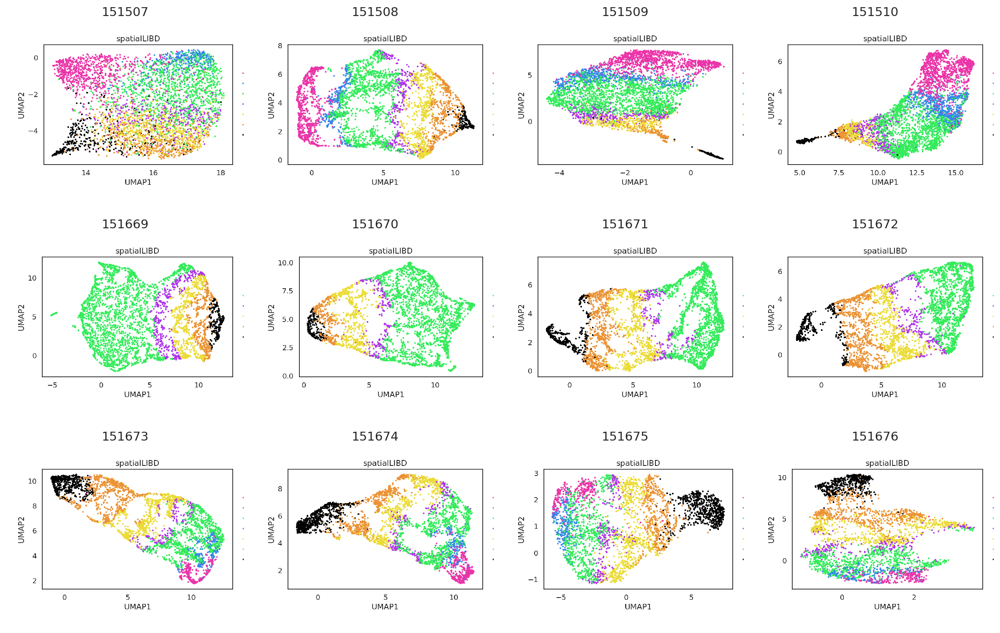

In [39]:
fig, axes = combine_images(MASK_simba_spatial_RNA_output_df, img_path_col='umap_fig_png')
plt.show()

## Mask + RNA with correlation

In [18]:
MASK_CORR_simba_spatial_RNA_output_fn = "../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/run_simba_spatial_and_rna.output.tsv"
MASK_CORR_simba_spatial_RNA_output_df = pd.read_csv(MASK_CORR_simba_spatial_RNA_output_fn, sep='\t', index_col=0)

In [20]:
MASK_CORR_simba_spatial_RNA_output_df = generate_umap_figures(
    MASK_CORR_simba_spatial_RNA_output_df,
    path_col='run_simba_spatial_and_rna',
    fig_path='../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png'],
)

Saving results in: ../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/UMAP


100%|██████████| 12/12 [01:51<00:00,  9.26s/it]


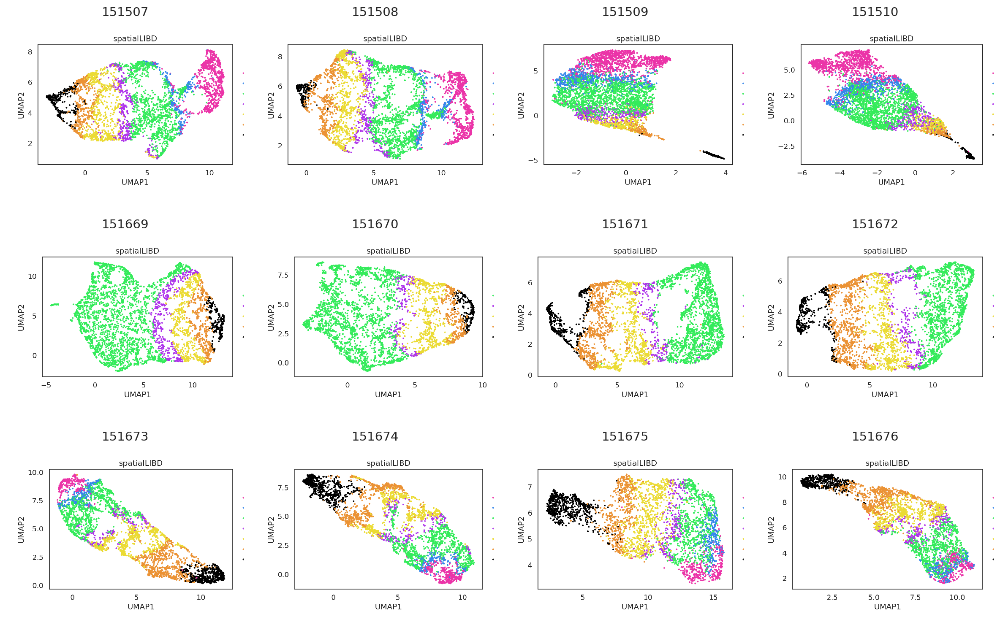

In [21]:
fig, axes = combine_images(MASK_CORR_simba_spatial_RNA_output_df, img_path_col='umap_fig_png')
plt.show()

## Gaussian + RNA (no correlation)

In [11]:
GAUSSIAN_simba_spatial_RNA_output_fn = "../results/00/simba_spatial_and_rna/gaussian_e3_sF_w1.0/run_simba_spatial_only.output.tsv" # typo
GAUSSIAN_simba_spatial_RNA_output_df = pd.read_csv(GAUSSIAN_simba_spatial_RNA_output_fn, sep='\t', index_col=0)

In [12]:
GAUSSIAN_simba_spatial_RNA_output_df = generate_umap_figures(
    GAUSSIAN_simba_spatial_RNA_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_and_rna/gaussian_e3_sF_w1.0/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png'],
)

Saving results in: ../results/00/simba_spatial_and_rna/gaussian_e3_sF_w1.0/UMAP


100%|██████████| 12/12 [02:06<00:00, 10.52s/it]


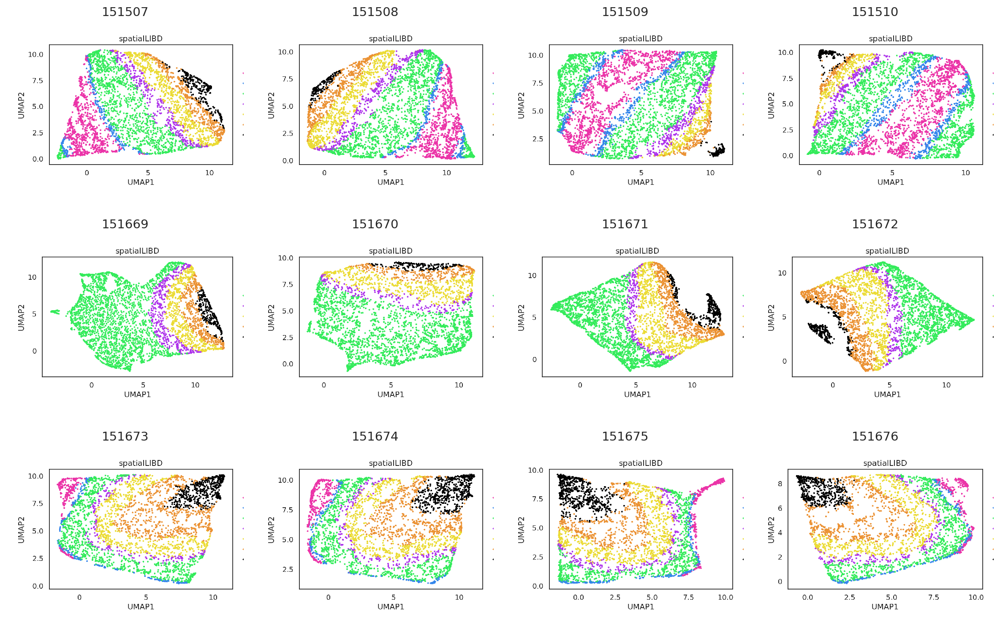

In [13]:
fig, axes = combine_images(GAUSSIAN_simba_spatial_RNA_output_df, img_path_col='umap_fig_png')
plt.show()

## Gaussian + RNA with correlation

## RBF + RNA (no correlation)

In [15]:
RBF_simba_spatial_RNA_output_fn = "../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/run_simba_spatial_only.output.tsv" # typo
RBF_simba_spatial_RNA_output_df = pd.read_csv(RBF_simba_spatial_RNA_output_fn, sep='\t', index_col=0)

In [16]:
RBF_simba_spatial_RNA_output_df = generate_umap_figures(
    RBF_simba_spatial_RNA_output_df,
    path_col='run_simba_spatial_only',
    fig_path='../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/UMAP',
    adata_color_col='spatialLIBD',
    fig_exts=['png'],
)

Saving results in: ../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/UMAP


100%|██████████| 12/12 [01:48<00:00,  9.06s/it]


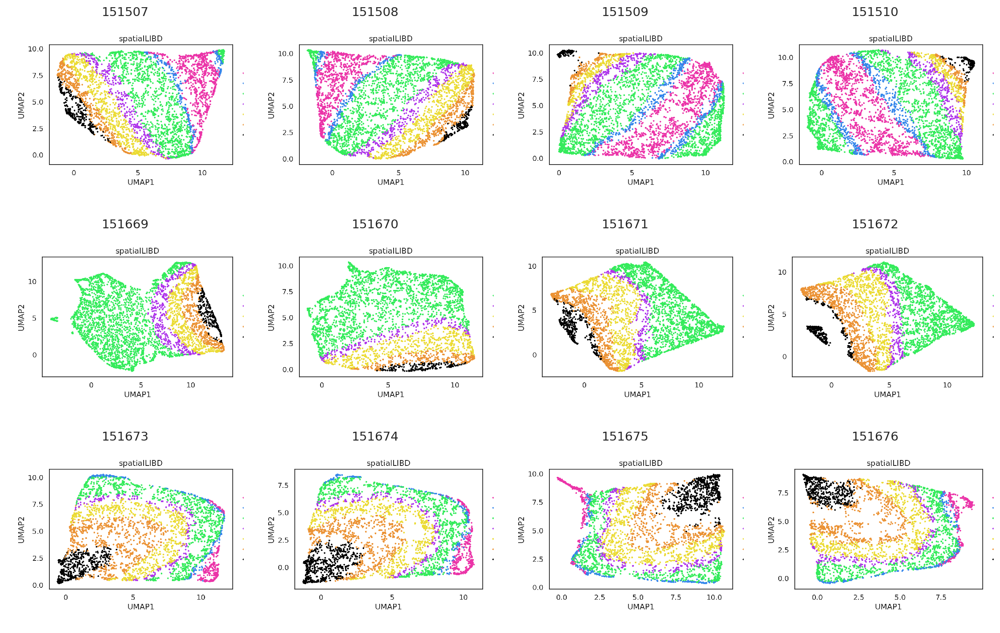

In [17]:
fig, axes = combine_images(RBF_simba_spatial_RNA_output_df, img_path_col='umap_fig_png')
plt.show()

## RBF + RNA with correlation